# Tracking Plastic Particles Around Indonesia 

Here is the code to run an OceanParcels simulation around Sulawesi Island in Indonesia

Firstly, load the modules into this jupyter environment:

In [78]:
%matplotlib inline 
from parcels import FieldSet, ParticleSet, Variable, JITParticle, AdvectionRK4, plotTrajectoriesFile, AdvectionRK4_3D, Field, ScipyParticle, ErrorCode
import numpy as np 
import math 
from datetime import timedelta
from datetime import timedelta as delta
from operator import attrgetter 
import os 
from glob import glob
from os import path
import xarray as xr 
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings('ignore',category=UserWarning)


Call the directory locations and variables

In [79]:
filenames = {'U':sorted(glob('hycom\wet_season_20202021\*.nc4')),
            'V':sorted(glob('hycom\wet_season_20202021\*.nc4'))}

variables = {'U':'water_u',
            'V':'water_v'}

dimensions = {'lat':'lat',
             'lon':'lon',
             'time':'time'}

Build a fieldset class which holds the hydrodynamic data needed to execute the particles:

In [80]:
fieldset = FieldSet.from_netcdf(filenames, variables, dimensions , vmin=-2000,allow_time_extrapolation=True)

Create a ParticleSet class to store particle information

In [81]:
npart = 10  # number of particles to be released
lon = [124.8] * npart
lat = [1.72] * npart 
repeatdt = delta(hours=24)  # release from the same set of locations every 24 hours

pset = ParticleSet(fieldset=fieldset, pclass=JITParticle, lon=lon, lat=lat, repeatdt=repeatdt)

Plot the starting position of the particles 

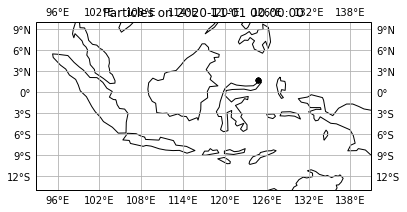

In [82]:
pset.show()

Create a function to remove the particle once it hits the model boundary

In [83]:
def DeleteParticle(particle,fieldset,time):
    particle.delete()

Execute the ParticleSet (run the model) and save to file 

Exception ignored in: <bound method ParticleFile.__del__ of <parcels.particlefile.ParticleFile object at 0x0000027B096BD6A0>>
Traceback (most recent call last):
  File "C:\Users\nkj19blc\Anaconda3\envs\py3_parcels\lib\site-packages\parcels\particlefile.py", line 189, in __del__
    self.close()
  File "C:\Users\nkj19blc\Anaconda3\envs\py3_parcels\lib\site-packages\parcels\particlefile.py", line 194, in close
    self.export()
  File "C:\Users\nkj19blc\Anaconda3\envs\py3_parcels\lib\site-packages\parcels\particlefile.py", line 317, in export
    self.open_netcdf_file(data.shape)
  File "C:\Users\nkj19blc\Anaconda3\envs\py3_parcels\lib\site-packages\parcels\particlefile.py", line 118, in open_netcdf_file
    os.remove(str(fname))
PermissionError: [WinError 32] The process cannot access the file because it is being used by another process: 'filename.nc'
INFO: Compiled JITParticleAdvectionRK4 ==> C:\Users\nkj19blc\AppData\Local\Temp\parcels-tmp\ebcd92249cf0bd9882b622a98595271d_0.dll
INFO: 

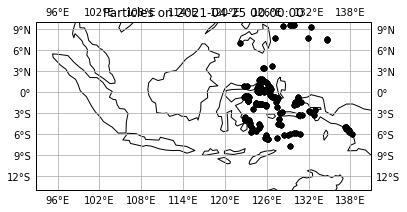

In [84]:
output_file = pset.ParticleFile(name="filename.nc", outputdt=timedelta(hours=6)) # the file name and the time step of the outputs

kernels = pset.Kernel(AdvectionRK4) #AdvectionRK4_3D advect the particles using the AdvectionRK4_3D kernel. This needs to happen before the next line. 
pset.execute(kernels,              
             runtime=delta(days=175), # total length of the run 
             dt=delta(hours=3),     # the timestep of the kernel 
             output_file=output_file,
             recovery={ErrorCode.ErrorOutOfBounds: DeleteParticle})
pset.show() 


# Plot videos of particle trajectory 

In [ ]:
import xarray as xr
from datetime import timedelta as delta
import numpy as np 
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib.pyplot as plt
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
import cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import matplotlib.animation as animation

Animation size has reached 20993014 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


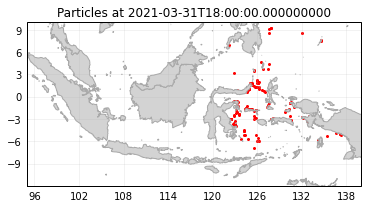

In [85]:
# enter your result file location and name 
data_xarray = xr.open_dataset(r'filename.nc') 

# this should be the same as your model dt
outputdt = delta(hours=6) 

# creating timerange variable (in nanoseconds)
timerange = np.arange(np.nanmin(data_xarray['time'].values),
                      np.nanmax(data_xarray['time'].values)+np.timedelta64(outputdt), 
                      outputdt)  

fname = r'ne_10m_admin_0_countries\ne_10m_admin_0_countries.shp'

# set up figure options 
fig = plt.figure(figsize=(5,5),constrained_layout=True)
proj = ccrs.PlateCarree()
ax = plt.axes(projection=proj)

# set up grid and axis tick labels
gridlines = ax.gridlines(draw_labels=True,alpha=0.2,edgecolor='lightgray')
gridlines.xlabels_top = None
gridlines.ylabels_right = None

plt.xlim([95, 140])
plt.ylim([-12, 10])

# plot particles
time_id = np.where(data_xarray['time'] == timerange[0]) # Indices of the data where time = 0
scatter = ax.scatter(data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id],s=1,facecolor='red')

# plot coastlines
adm1_shapes = list(shpreader.Reader(fname).geometries())
ax.add_geometries(adm1_shapes, ccrs.PlateCarree(), edgecolor='darkgrey', facecolor='lightgray')

# set title 
t = str(timerange[0])
title = ax.set_title('Particles at '+t)

# outline which sections of the plot to animate
def animate(i):
    t = str(timerange[i])
    title.set_text('Particles at '+t)
    
    time_id = np.where(data_xarray['time'] == timerange[i])
    scatter.set_offsets(np.c_[data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id]])
    
# write animation
anim = FuncAnimation(fig, animate, frames = len(timerange), interval=100)

# find the ffmpeg.exe file within your py3_parcels environment in your file finder and copy the address to here
plt.rcParams['animation.ffmpeg_path'] =r'C:\Users\nkj19blc\Anaconda3\envs\py3_parcels\Library\bin\ffmpeg.exe'
writervideo = animation.FFMpegWriter() 

#identify the filename you want to use and where you want to save it 
anim.save(r'6monthtest.mp4', writer=writervideo,dpi=300)

# write the video in html so it appears in this notebook as well 
HTML(anim.to_jshtml())

